<a href="https://colab.research.google.com/github/Michael-Santoro/HMProductRecommendation/blob/main/SalesPrediction_Part1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Sales Prediction - Part 1
**Michael Santoro - michael.santoro@du.edu**</br>
With the discovery required to accomplish the image decompisition there was alot to be worked through. So the work will be split between multiple notebooks with the take-aways from the work from the previous notebook.
1. Part 1 - Data Cleaning, Model Selection, Feature Reduction
1. Part 2 - Transaction Analysis
# Introduction
This problem was initially introduced as a Kaggle competition. [source](https://www.kaggle.com/c/h-and-m-personalized-fashion-recommendations/overview)

The general idea being that images of articles can be simplified in terms of features using similar deep learning model architectures that are used for image classification. Then the simplified feature space can be used to cluster. These clusters then can be used to encode transactions into cluster sets. Once the cluster sets are put together, a recomendation can be made to a customer for another items that others are adding to their cart.

# Kaggle Download and Packages Install

In [ ]:
!mkdir ~/.kaggle/
!cp kaggle.json ~/.kaggle/kaggle.json
!kaggle config set path -v /content
!kaggle competitions download -c h-and-m-personalized-fashion-recommendations

import os
import zipfile

zip_ref = zipfile.ZipFile('/content/h-and-m-personalized-fashion-recommendations.zip', 'r')
zip_ref.extractall()
zip_ref.close()

#Hugging Face
!pip install transformers

#UMAP
!pip install umap-learn

usage: kaggle config set
       [-h]
       -n
       NAME
       -v
       VALUE
kaggle config set: error: the following arguments are required: -n/--name
100% 28.7G/28.7G [04:07<00:00, 112MB/s]
100% 28.7G/28.7G [04:07<00:00, 124MB/s]
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.3/6.3 MB 51.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 105.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.3/190.3 KB 23.9 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 KB 4.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 24.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829

# Imports

In [ ]:
import os
import pandas as pd
import numpy as np

from PIL import Image

from transformers import AutoImageProcessor, ViTModel, ImageGPTModel, ViTMAEModel

import torch
from torch import nn
from torchsummary import summary
import copy
from collections import defaultdict

from scipy.spatial.distance import cdist
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from skimage.measure import block_reduce
import matplotlib.pyplot as plt

import seaborn as sns
import plotly.express as px
import umap

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
img_dir = '/content/images'

# Data Analysis
## Available Images
The Kaggle description mentions that there is not images for all articles of clothing so first things first. We will collect all the available images by searching through the image files.

In [ ]:
tree = os.walk('/content/images')
images_available = []
for i in tree:
  # print(i)
  if i[0] != '/content/images':
    for j in i[-1]:
      images_available.append(j.split('.')[0])
len(images_available)

105100

## Clothing Articles
Meta data for all of the clothing articles are stored in the articles csv. To work through this experiment my goal is to find a couple of distinct classes of clothing that are labeled. My goal is to find something like jeans and t-shirts categories. So the 'product_type_names' are printed below.

In [ ]:
articles = pd.read_csv('articles.csv', low_memory=False)
articles.article_id = articles.article_id.astype('str').str.zfill(10)
articles = articles[articles.article_id.isin(images_available)]
articles.product_type_name.unique()

array(['Vest top', 'Bra', 'Underwear Tights', 'Socks', 'Leggings/Tights',
       'Sweater', 'Top', 'Trousers', 'Hair clip', 'Umbrella',
       'Pyjama jumpsuit/playsuit', 'Bodysuit', 'Hair string', 'Unknown',
       'Hoodie', 'Sleep Bag', 'Hair/alice band', 'Belt', 'Boots',
       'Bikini top', 'Swimwear bottom', 'Underwear bottom', 'Swimsuit',
       'Skirt', 'T-shirt', 'Dress', 'Hat/beanie', 'Kids Underwear top',
       'Shorts', 'Shirt', 'Cap/peaked', 'Pyjama set', 'Sneakers',
       'Sunglasses', 'Cardigan', 'Gloves', 'Earring', 'Bag', 'Blazer',
       'Other shoe', 'Jumpsuit/Playsuit', 'Sandals', 'Jacket', 'Costumes',
       'Robe', 'Scarf', 'Coat', 'Other accessories', 'Polo shirt',
       'Slippers', 'Night gown', 'Alice band', 'Straw hat', 'Hat/brim',
       'Tailored Waistcoat', 'Ballerinas', 'Tie', 'Necklace',
       'Pyjama bottom', 'Felt hat', 'Bracelet', 'Blouse',
       'Outdoor overall', 'Watch', 'Underwear body', 'Beanie', 'Giftbox',
       'Sleeping sack', 'Dungarees',

Next we will pick up a couple of different dataframes for verification of the embedding methodology, which is as reminder a clustering embedding of the clothing image. Below there is a print out of qty of examples per category and a print out of an example.

Jeans Samples: 309


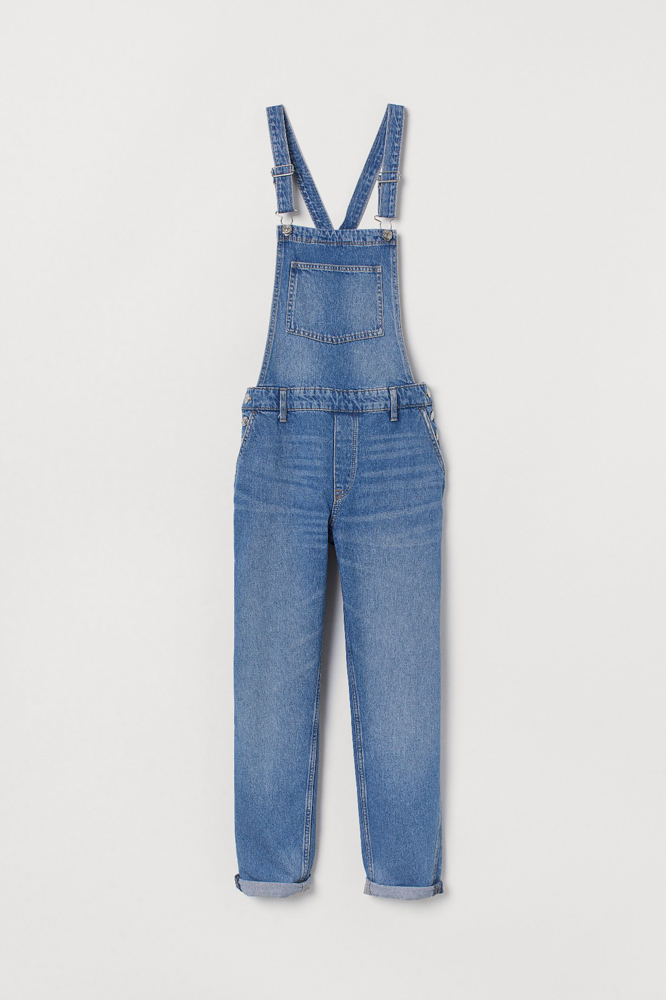

T-Shirts Samples: 7880


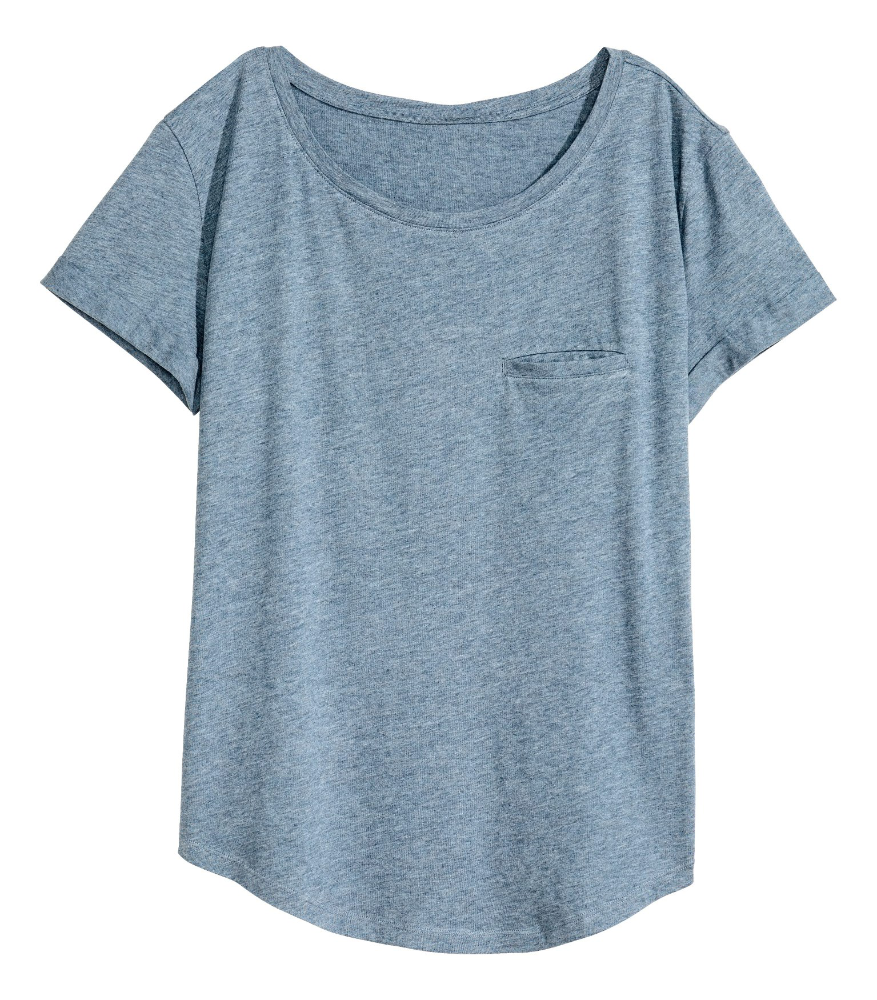

Blazer Samples: 1108


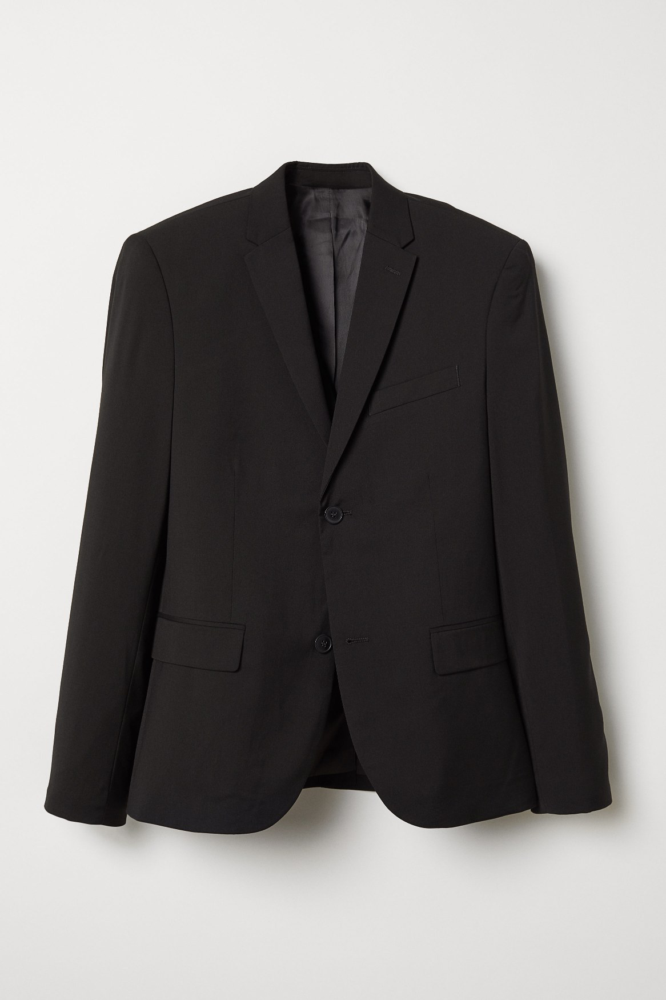

Dress Samples: 10348


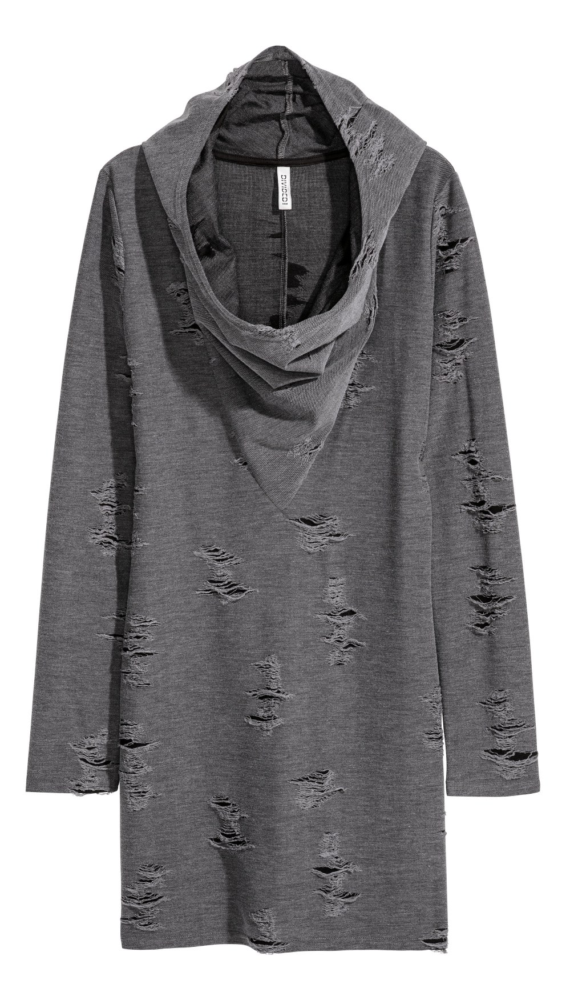

Boots Samples: 1028


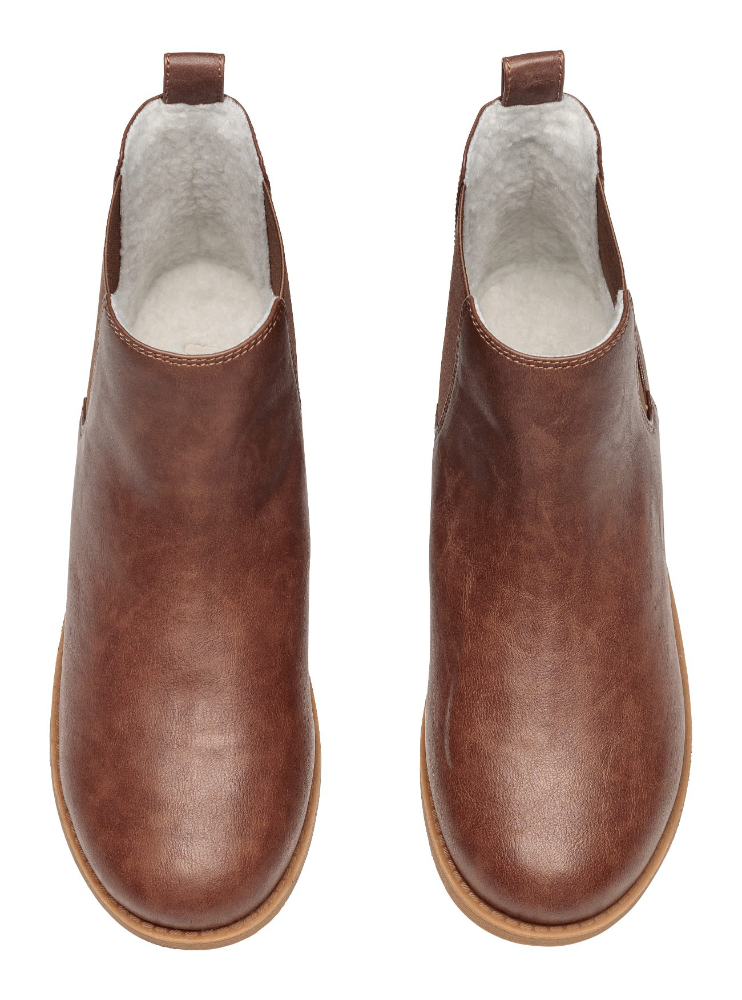

In [ ]:
jeans = articles[(articles.product_type_name=='Dungarees')].reset_index(drop=True)
jeans.name = 'jeans'
t_shirts = articles[articles.product_type_name=='T-shirt'].reset_index(drop=True)
t_shirts.name = 't_shirts'
blazer = articles[articles.product_type_name=='Blazer'].reset_index(drop=True)
blazer.name = 'blazer'
dress = articles[articles.product_type_name=='Dress'].reset_index(drop=True)
dress.name = 'dress'
boots = articles[articles.product_type_name=='Boots'].reset_index(drop=True)
boots.name = 'boots'


print(f'Jeans Samples: {jeans.shape[0]}')
im = Image.open(os.path.join(img_dir, jeans.loc[0].article_id[:3], f'{jeans.loc[0].article_id}.jpg'))
display(im)
print(f'T-Shirts Samples: {t_shirts.shape[0]}')
im = Image.open(os.path.join(img_dir, t_shirts.loc[0].article_id[:3], f'{t_shirts.loc[0].article_id}.jpg'))
display(im)
print(f'Blazer Samples: {blazer.shape[0]}')
im = Image.open(os.path.join(img_dir, blazer.loc[0].article_id[:3], f'{blazer.loc[0].article_id}.jpg'))
display(im)
print(f'Dress Samples: {dress.shape[0]}')
im = Image.open(os.path.join(img_dir, dress.loc[0].article_id[:3], f'{dress.loc[0].article_id}.jpg'))
display(im)
print(f'Boots Samples: {boots.shape[0]}')
im = Image.open(os.path.join(img_dir, boots.loc[0].article_id[:3], f'{boots.loc[0].article_id}.jpg'))
display(im)

# Model Decomposition Comparison
The plan is compare the results of a couple different transformer type models that are used for image classification. A small smaple of 25 will be used to judged by the plot of PCA.


In [ ]:
n = 25

## ViT
The Vision Transformer (ViT) model was proposed in [An Image is Worth 16x16 Words: Transformers for Image Recognition at Scale](https://arxiv.org/abs/2010.11929)
The abstract from the paper is the following:

*While the Transformer architecture has become the de-facto standard for natural language processing tasks, its applications to computer vision remain limited. In vision, attention is either applied in conjunction with convolutional networks, or used to replace certain components of convolutional networks while keeping their overall structure in place. We show that this reliance on CNNs is not necessary and a pure transformer applied directly to sequences of image patches can perform very well on image classification tasks. When pre-trained on large amounts of data and transferred to multiple mid-sized or small image recognition benchmarks (ImageNet, CIFAR-100, VTAB, etc.), Vision Transformer (ViT) attains excellent results compared to state-of-the-art convolutional networks while requiring substantially fewer computational resources to train.*

The experiment is using a [pre-trained model](https://huggingface.co/google/vit-base-patch16-224-in21k) was trained by Google on the ImageNet-21k (14 million images, 21,843 classes) at resolution 224x224.



<AxesSubplot:xlabel='x', ylabel='y'>

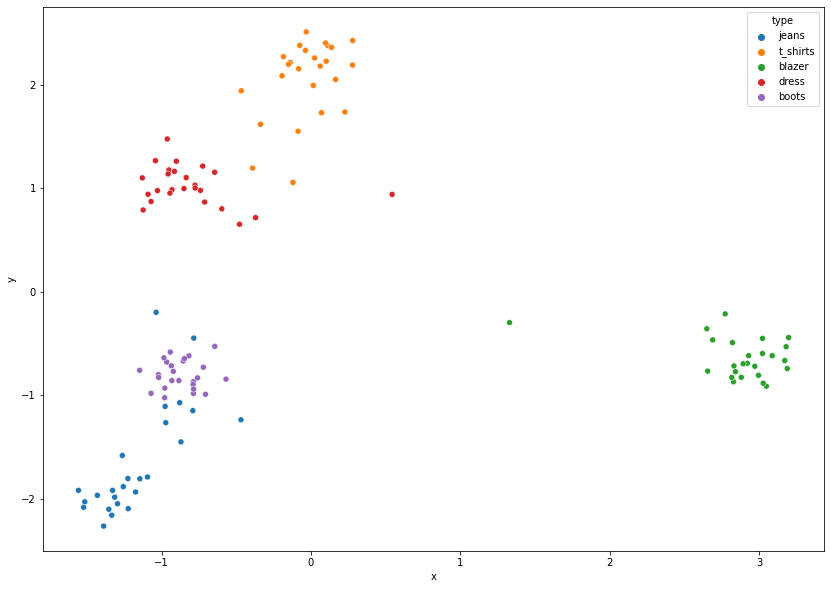

In [ ]:
image_processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
model = ViTModel.from_pretrained("google/vit-base-patch16-224-in21k")
model.to(device)

def getFeatureVecor_mean(art_num):
  im = Image.open(os.path.join(img_dir, art_num[:3], f'{art_num}.jpg'))
  inputs = image_processor(images=im, return_tensors="pt").to(device)
  with torch.no_grad():
    outputs = model(**inputs)
  arr = outputs['last_hidden_state'].cpu().detach().numpy()
  #arr dims => (1, 197, 768)
  return arr.mean(axis=1).reshape(768,)

type_list = []
processed = []

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_mean(frame.loc[i].article_id))
      type_list.append(frame.name)

pca = PCA(n_components=2)
X = np.array(processed)
reduced = pca.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y'])
df['type'] = type_list

plt.figure(figsize=(14,10))
sns.scatterplot(data=df, x="x", y="y", hue="type")

## ImageGPT
[model link](https://huggingface.co/docs/transformers/model_doc/imagegpt)

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.


Some weights of the model checkpoint at openai/imagegpt-small were not used when initializing ImageGPTModel: ['lm_head.weight']
- This IS expected if you are initializing ImageGPTModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing ImageGPTModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


<AxesSubplot:xlabel='x', ylabel='y'>

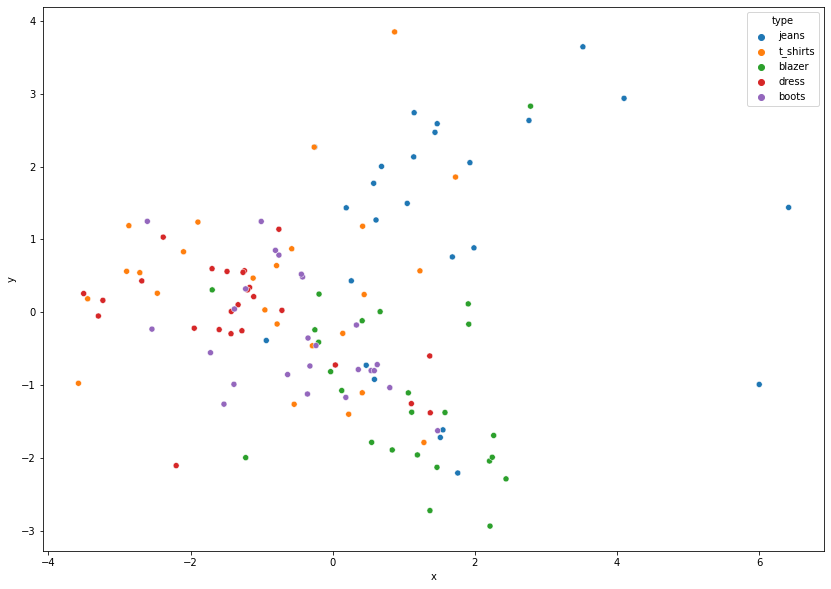

In [ ]:
image_processor = AutoImageProcessor.from_pretrained("openai/imagegpt-small")
model = ImageGPTModel.from_pretrained("openai/imagegpt-small")
model.to(device)

def getFeatureVecor_mean(art_num):
  im = Image.open(os.path.join(img_dir, art_num[:3], f'{art_num}.jpg'))
  inputs = image_processor(images=im, return_tensors="pt").to(device)
  with torch.no_grad():
    outputs = model(**inputs)
  arr = outputs['last_hidden_state'].cpu().detach().numpy()
  #arr dims => (1, 1024, 512)
  return arr.mean(axis=1).reshape(512,)

type_list = []
processed = []

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_mean(frame.loc[i].article_id))
      type_list.append(frame.name)

pca = PCA(n_components=2)
X = np.array(processed)
reduced = pca.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y'])
df['type'] = type_list

plt.figure(figsize=(14,10))
sns.scatterplot(data=df, x="x", y="y", hue="type")

## ViTMAE
[model link](https://huggingface.co/docs/transformers/model_doc/vit_mae#transformers.ViTMAEModel)

Some weights of the model checkpoint at facebook/vit-mae-base were not used when initializing ViTMAEModel: ['decoder.decoder_layers.6.layernorm_after.weight', 'decoder.decoder_layers.4.attention.output.dense.bias', 'decoder.decoder_layers.3.output.dense.weight', 'decoder.decoder_layers.2.attention.attention.key.bias', 'decoder.decoder_layers.6.attention.attention.query.weight', 'decoder.decoder_layers.6.attention.attention.key.bias', 'decoder.decoder_layers.2.attention.attention.key.weight', 'decoder.decoder_layers.1.intermediate.dense.bias', 'decoder.decoder_layers.4.attention.output.dense.weight', 'decoder.decoder_layers.4.layernorm_before.bias', 'decoder.decoder_layers.7.intermediate.dense.weight', 'decoder.decoder_layers.6.layernorm_before.bias', 'decoder.decoder_layers.0.output.dense.weight', 'decoder.decoder_layers.5.attention.attention.query.bias', 'decoder.decoder_layers.5.output.dense.bias', 'decoder.decoder_layers.1.layernorm_before.weight', 'decoder.decoder_layers.7.attentio

<AxesSubplot:xlabel='x', ylabel='y'>

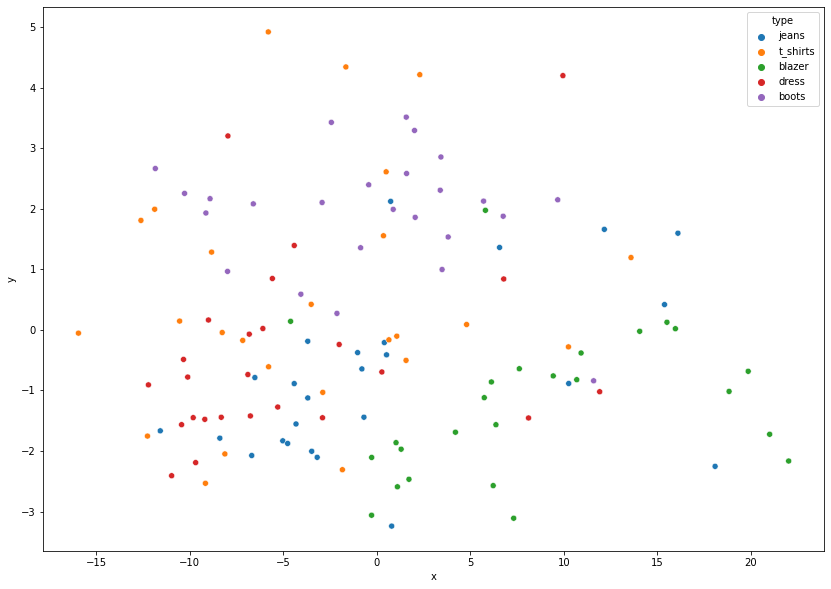

In [ ]:
image_processor = AutoImageProcessor.from_pretrained('facebook/vit-mae-base')
model = ViTMAEModel.from_pretrained('facebook/vit-mae-base')
model.to(device)

def getFeatureVecor_mean(art_num):
  im = Image.open(os.path.join(img_dir, art_num[:3], f'{art_num}.jpg'))
  inputs = image_processor(images=im, return_tensors="pt").to(device)
  with torch.no_grad():
    outputs = model(**inputs)
  arr = outputs['last_hidden_state'].cpu().detach().numpy()
  return arr.mean(axis=1).reshape(768,)

type_list = []
processed = []

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_mean(frame.loc[i].article_id))
      type_list.append(frame.name)

pca = PCA(n_components=2)
X = np.array(processed)
reduced = pca.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y'])
df['type'] = type_list

plt.figure(figsize=(14,10))
sns.scatterplot(data=df, x="x", y="y", hue="type")

## Model Selection Wrap-Up
The model that has the most clustered results is the ViT model and we will continue with that model.



# Hidden State Simplification
To compare the models a mean was completed along an axis and probably a more appropiate operation would be a meanpooling or maxpooling this may theortically retain more signal as we work in this latent space on the combination of the multi-head attention output. This will be a visual assesment for this review as-well

In [ ]:
n = 50
image_processor = AutoImageProcessor.from_pretrained("google/vit-base-patch16-224-in21k")
model = ViTModel.from_pretrained("google/vit-base-patch16-224-in21k")
model.to(device)

ViTModel(
  (embeddings): ViTEmbeddings(
    (patch_embeddings): ViTPatchEmbeddings(
      (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
    )
    (dropout): Dropout(p=0.0, inplace=False)
  )
  (encoder): ViTEncoder(
    (layer): ModuleList(
      (0): ViTLayer(
        (attention): ViTAttention(
          (attention): ViTSelfAttention(
            (query): Linear(in_features=768, out_features=768, bias=True)
            (key): Linear(in_features=768, out_features=768, bias=True)
            (value): Linear(in_features=768, out_features=768, bias=True)
            (dropout): Dropout(p=0.0, inplace=False)
          )
          (output): ViTSelfOutput(
            (dense): Linear(in_features=768, out_features=768, bias=True)
            (dropout): Dropout(p=0.0, inplace=False)
          )
        )
        (intermediate): ViTIntermediate(
          (dense): Linear(in_features=768, out_features=3072, bias=True)
          (intermediate_act_fn): GELUActivation()
      

## Mean Decompisition

<AxesSubplot:xlabel='x', ylabel='y'>

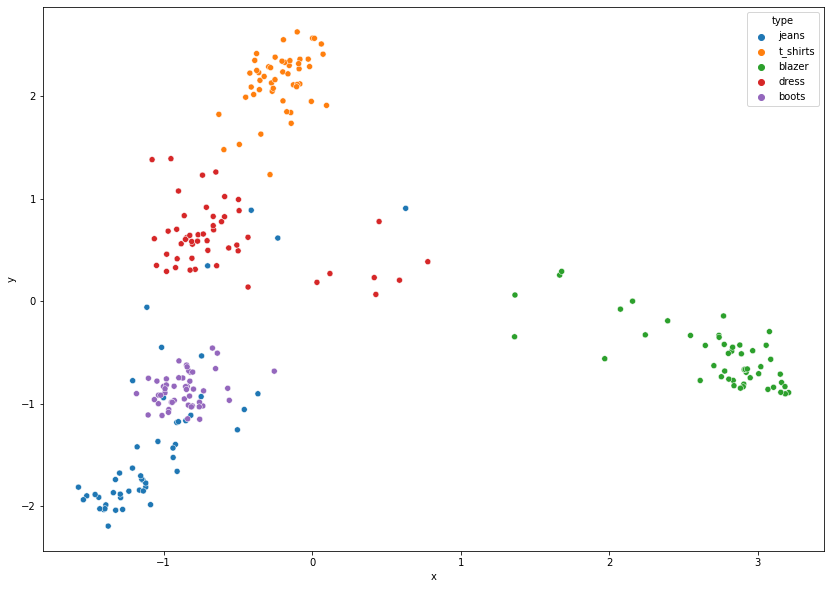

In [ ]:
type_list = []
processed = []

def getFeatureVecor_mean(art_num):
  im = Image.open(os.path.join(img_dir, art_num[:3], f'{art_num}.jpg'))
  inputs = image_processor(images=im, return_tensors="pt").to(device)
  with torch.no_grad():
    outputs = model(**inputs)
  arr = outputs['last_hidden_state'].cpu().detach().numpy()
  #arr dims => (1, 197, 768)
  return arr.mean(axis=1).reshape(768,)

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_mean(frame.loc[i].article_id))
      type_list.append(frame.name)

pca = PCA(n_components=2)
X = np.array(processed)
reduced = pca.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y'])
df['type'] = type_list

plt.figure(figsize=(14,10))
sns.scatterplot(data=df, x="x", y="y", hue="type")

## Max Decomposition

<AxesSubplot:xlabel='x', ylabel='y'>

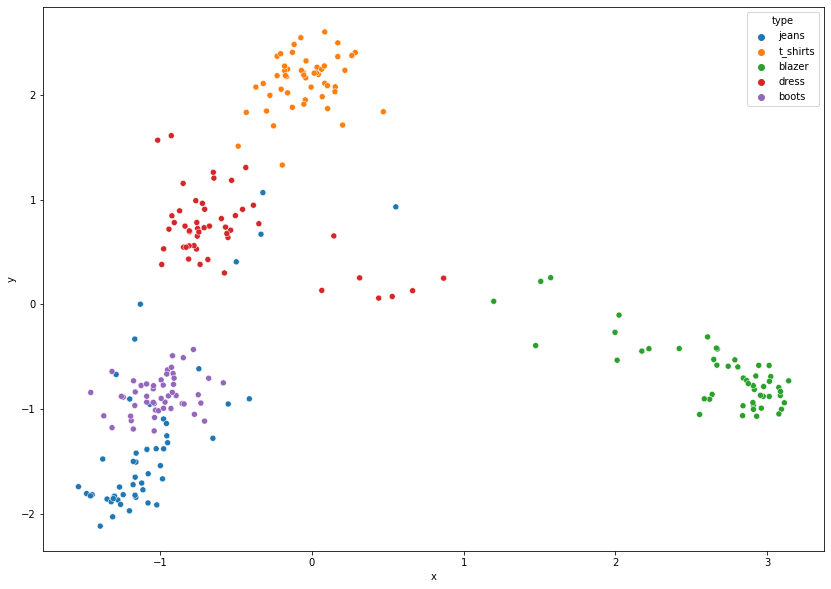

In [ ]:
type_list = []
processed = []

def getFeatureVecor_max(art_num):
  im = Image.open(os.path.join(img_dir, art_num[:3], f'{art_num}.jpg'))
  inputs = image_processor(images=im, return_tensors="pt").to(device)
  with torch.no_grad():
    outputs = model(**inputs)
  arr = outputs['last_hidden_state'].cpu().detach().numpy()
  #arr dims => (1, 197, 768)
  return arr.max(axis=1).reshape(768,)

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_max(frame.loc[i].article_id))
      type_list.append(frame.name)

pca = PCA(n_components=2)
X = np.array(processed)
reduced = pca.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y'])
df['type'] = type_list

plt.figure(figsize=(14,10))
sns.scatterplot(data=df, x="x", y="y", hue="type")

## Avg Pooling

<AxesSubplot:xlabel='x', ylabel='y'>

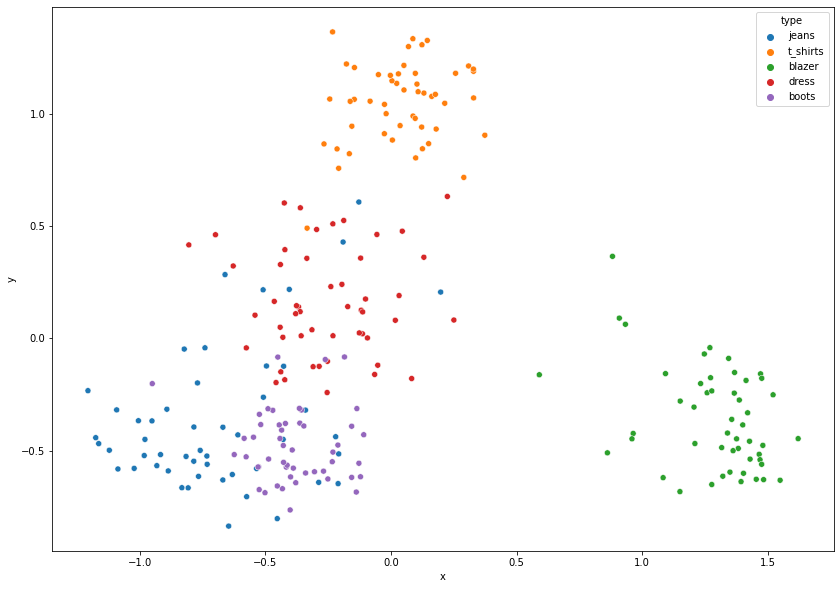

In [ ]:
type_list = []
processed = []

def getFeatureVecor_avgpool(art_num):
  im = Image.open(os.path.join(img_dir, art_num[:3], f'{art_num}.jpg'))
  inputs = image_processor(images=im, return_tensors="pt").to(device)
  with torch.no_grad():
    outputs = model(**inputs)
  arr = outputs['last_hidden_state'].cpu().detach().numpy()
  #arr dims => (1, 197, 768)
  return block_reduce(arr.reshape((197,768)), block_size=(6,12),func=np.mean).reshape(2112,)


for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_avgpool(frame.loc[i].article_id))
      type_list.append(frame.name)

pca = PCA(n_components=2)
X = np.array(processed)
reduced = pca.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y'])
df['type'] = type_list

plt.figure(figsize=(14,10))
sns.scatterplot(data=df, x="x", y="y", hue="type")

## Max Pool

<AxesSubplot:xlabel='x', ylabel='y'>

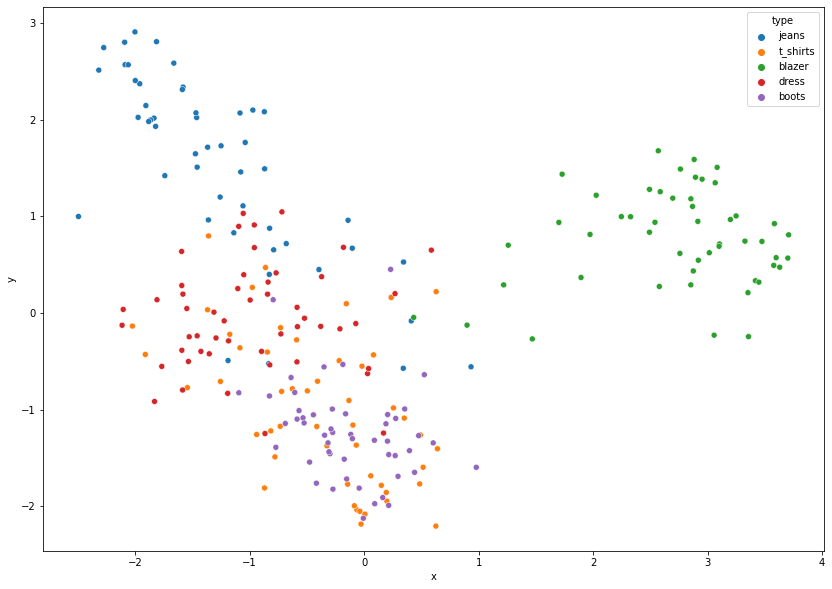

In [ ]:
type_list = []
processed = []

def getFeatureVecor_maxpool(art_num):
  im = Image.open(os.path.join(img_dir, art_num[:3], f'{art_num}.jpg'))
  inputs = image_processor(images=im, return_tensors="pt").to(device)
  with torch.no_grad():
    outputs = model(**inputs)
  arr = outputs['last_hidden_state'].cpu().detach().numpy()
  #arr dims => (1, 197, 768)
  return block_reduce(arr.reshape((197,768)), block_size=(6,12),func=np.max).reshape(2112,)

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_maxpool(frame.loc[i].article_id))
      type_list.append(frame.name)

pca = PCA(n_components=2)
X = np.array(processed)
reduced = pca.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y'])
df['type'] = type_list

plt.figure(figsize=(14,10))
sns.scatterplot(data=df, x="x", y="y", hue="type")

## Hidden State Wrap-Up
After review of the different methods of reducing this representation of the attention layers. The mean across for the simplification seams to be the most effective.

# UMAP vs PCA - 2D Deconstruction
**TO-DO** UMAP Description Here

<AxesSubplot:xlabel='x', ylabel='y'>

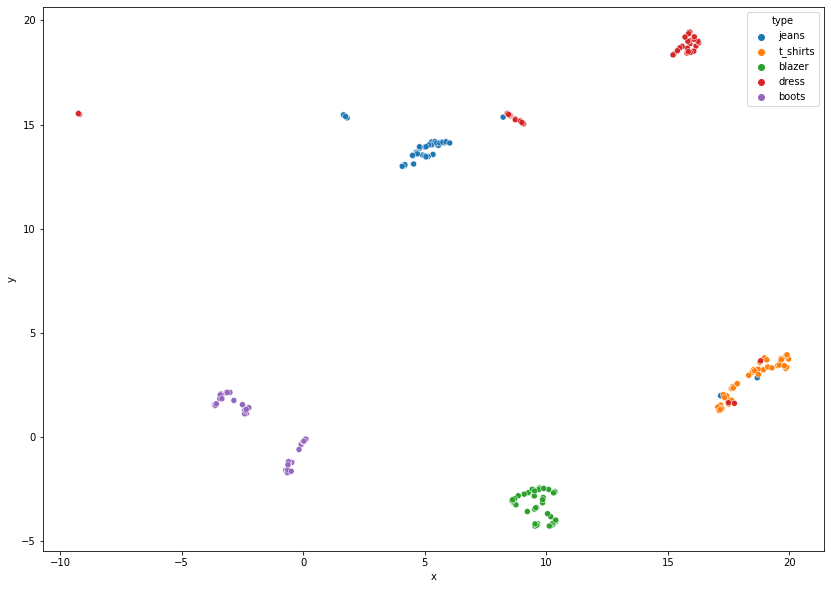

In [ ]:
_umap = umap.UMAP(
    n_neighbors=5,
    min_dist=0.0,
    n_components=2,
    random_state=42,
)

type_list = []
processed = []

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_mean(frame.loc[i].article_id))
      type_list.append(frame.name)

X = np.array(processed)
reduced = _umap.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y'])
df['type'] = type_list

plt.figure(figsize=(14,10))
sns.scatterplot(data=df, x="x", y="y", hue="type")

## UMAP 3D - Deconstruction

In [ ]:
_umap = umap.UMAP(
    n_neighbors=5,
    min_dist=0.0,
    n_components=3,
    random_state=42,
)

type_list = []
processed = []

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_mean(frame.loc[i].article_id))
      type_list.append(frame.name)

X = np.array(processed)
reduced = _umap.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y','z'])
df['type'] = type_list

fig = px.scatter_3d(df, x="x", y="y", z="z", color="type")
fig.show()


## UMAP Wrap-Up
The groupings in the data can pretty clearly seen in the UMAP output. There are a couple points that should be explored in the data to see what is going on.

# Deep Dive on Some Data Details
This section will deep dive a couple of the points in the plot that seem to be suspect. Specifically the t-shirts are closely cooupled but there appears to be a couple jeans and dress examples sprikled in there, so we explore these points to see if these clothing articles are similar to t-shirts.


## Jeans
We are looking for jean labels where the 2D decomposition is $x>15$ and $y<8$.

In [ ]:
_jeans = df[df.type=='jeans'].reset_index(drop=True)
_jeans.head()

,x,y,type
0,1.683742,15.441543,jeans
1,1.656233,15.469111,jeans
2,5.496139,14.031392,jeans
3,5.279545,14.166438,jeans
4,5.416714,14.184278,jeans


Article: 0556215001


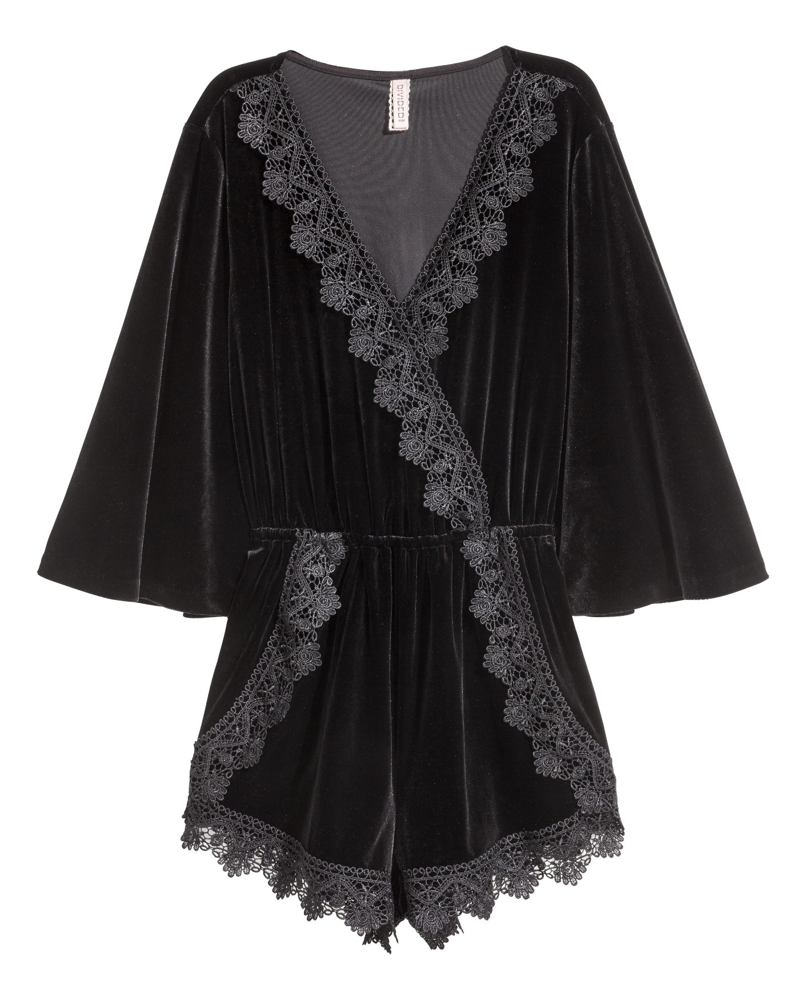

Article: 0579469001


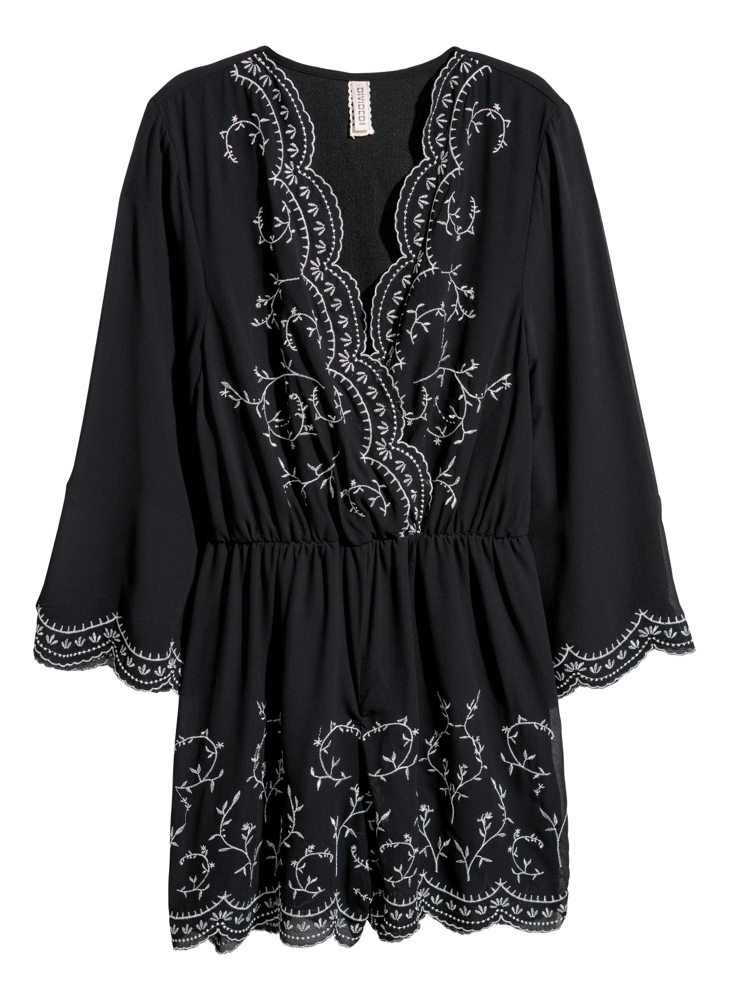

Article: 0580100002


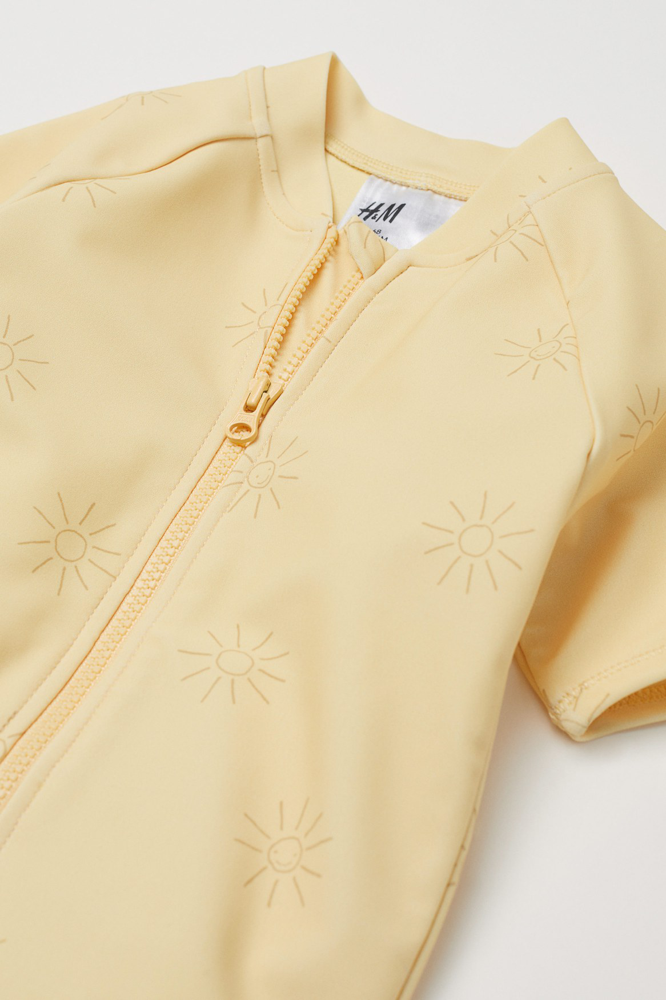

Article: 0588491002


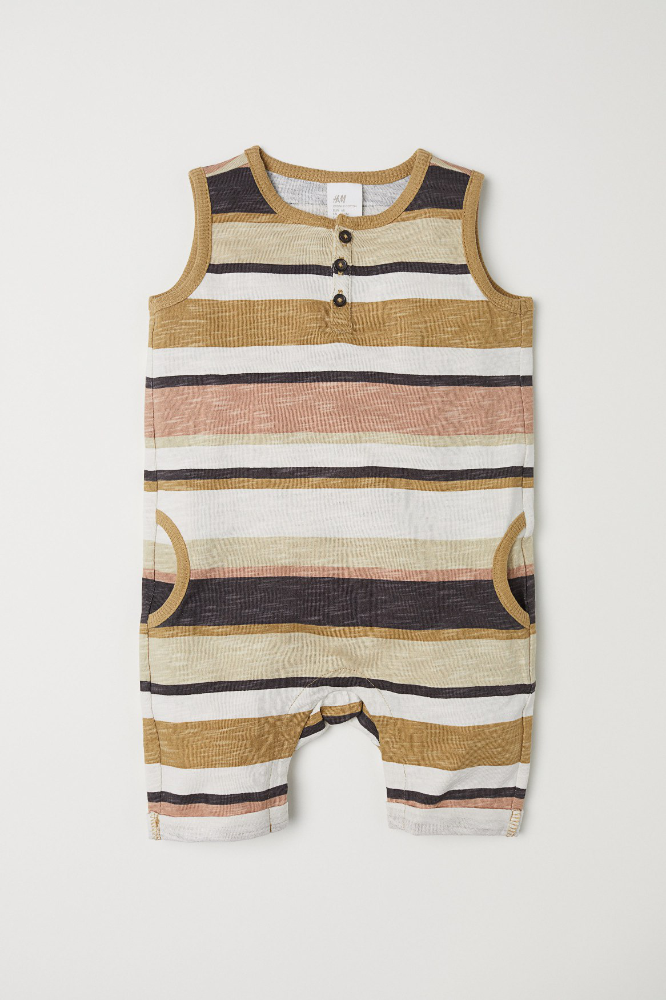

In [ ]:
arts = []
for idx in _jeans[(_jeans.x>15) & (_jeans.y<8)].index:
  print(f'Article: {jeans.loc[idx].article_id}')
  arts.append(jeans.loc[idx].article_id)
  im = Image.open(os.path.join(img_dir, jeans.iloc[idx].article_id[:3], f'{jeans.loc[idx].article_id}.jpg'))
  display(im)

After reviewing the above images we can see that these items do not look anything like jeans and kind of illustrate the complexity of the problem. When we assign singular labels to articles they can be mis-understood. Below I dig a little deeper analyzing the 'garment_group_name' field.

In [ ]:
articles[articles.article_id.isin(arts)]

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,detail_desc
13041,0556215001,556215,Krystal velvet jumpsuit,268,Dungarees,Garment Full body,1010016,Solid,9,Black,...,Projects Dresses,D,Divided,2,Divided,50,Divided Projects,1013,Dresses Ladies,"Velour playsuit with lace details, a wrapover ..."
18566,0579469001,579469,Petunia jumpsuit,268,Dungarees,Garment Full body,1010007,Embroidery,9,Black,...,Projects Dresses,D,Divided,2,Divided,50,Divided Projects,1013,Dresses Ladies,Jumpsuit in lightweight chiffon crêpe with a V...
18726,0580100002,580100,Thelonious sunprotection,268,Dungarees,Garment Full body,1010001,All over pattern,22,Yellow,...,Baby Exclusive,G,Baby Sizes 50-98,4,Baby/Children,44,Baby Essentials & Complements,1006,Woven/Jersey/Knitted mix Baby,Baby Exclusive. Swimsuit in UV-protective mate...
20333,0588491002,588491,NUBIS dungaree,268,Dungarees,Garment Full body,1010017,Stripe,14,Dark Beige,...,Baby Exclusive,G,Baby Sizes 50-98,4,Baby/Children,44,Baby Essentials & Complements,1006,Woven/Jersey/Knitted mix Baby,Baby Exclusive. Sleeveless romper suit in orga...


<AxesSubplot:>

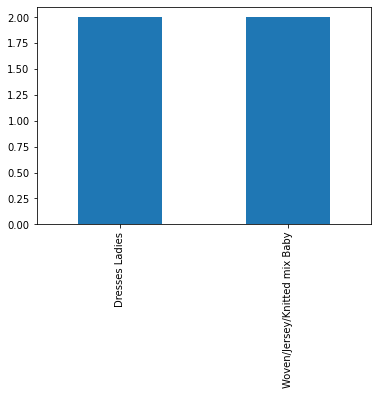

In [ ]:
articles[articles.article_id.isin(arts)].garment_group_name.value_counts().plot(kind='bar')

The above is very interesting this is actually saying that two of these items are in a sub-categroy of dresses ladies. Below is the value counts of the full category, a better subset for jeans would have likely been 'Dungarees' and 'Trousers Denim'.

<AxesSubplot:>

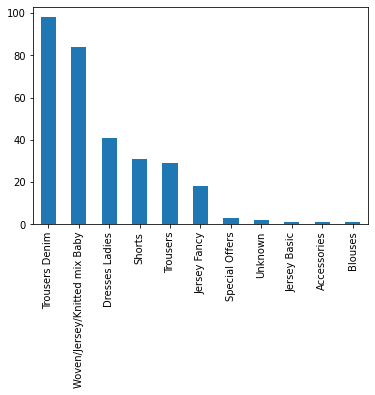

In [ ]:
jeans.garment_group_name.value_counts().plot(kind='bar')

## Dresses
We are looking for jean labels where the 2D decomposition is $x>15$ and $y<8$.

In [ ]:
_dress = df[df.type=='dress'].reset_index(drop=True)
_dress.head()

,x,y,type
0,17.494263,1.647595,dress
1,18.815142,3.655390,dress
2,15.256603,18.390362,dress
3,15.232879,18.373522,dress
4,16.043634,18.507858,dress


Article: 0192460006


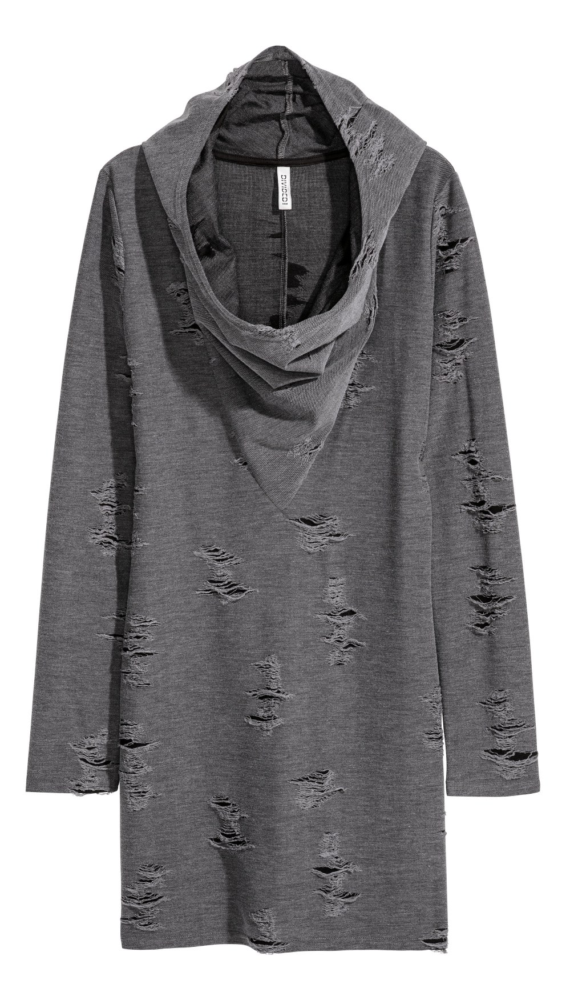

Article: 0202017055


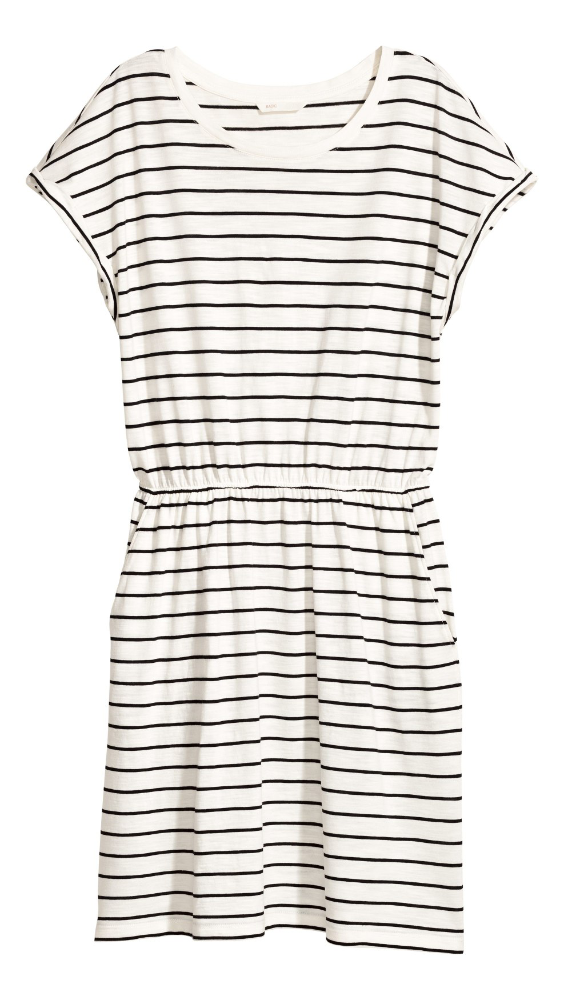

Article: 0272591023


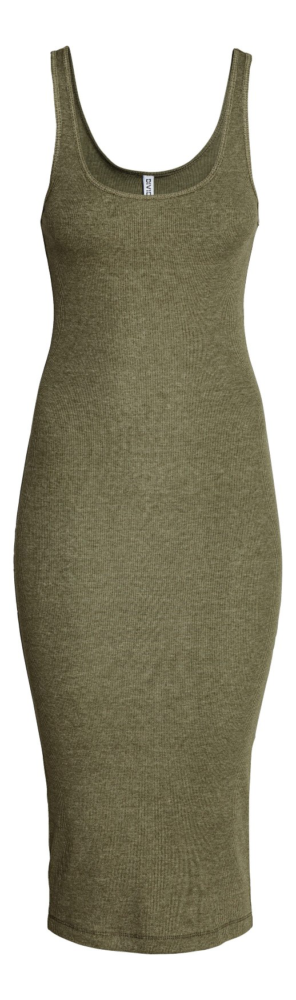

In [ ]:
arts = []
for idx in _dress[(_dress.x>15) & (_dress.y<8)].index:
  print(f'Article: {dress.loc[idx].article_id}')
  arts.append(dress.loc[idx].article_id)
  im = Image.open(os.path.join(img_dir, dress.iloc[idx].article_id[:3], f'{dress.loc[idx].article_id}.jpg'))
  display(im)

Again we find interesting results where visually these garments have textures and could have similar features to the t-shirt category.

In [ ]:
articles[articles.article_id.isin(arts)]

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,department_name,index_code,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,detail_desc
204,0192460006,192460,Knit dress,265,Dress,Garment Full body,1010016,Solid,8,Dark Grey,...,Tops Knitwear DS,D,Divided,2,Divided,58,Divided Selected,1003,Knitwear,"Short, fine-knit dress with a hood, waterfall ..."
238,0202017055,202017,Rihanna dress,265,Dress,Garment Full body,1010017,Stripe,10,White,...,Jersey Basic,A,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Short-sleeved dress in slub jersey with an ela...
632,0272591023,272591,Lena Rib Dress (1),265,Dress,Garment Full body,1010010,Melange,93,Dark Green,...,Basic 1,D,Divided,2,Divided,51,Divided Basics,1002,Jersey Basic,"Fitted, sleeveless dress in ribbed jersey."


<AxesSubplot:>

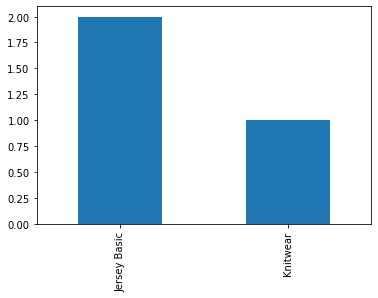

In [ ]:
articles[articles.article_id.isin(arts)].garment_group_name.value_counts().plot(kind='bar')

<AxesSubplot:>

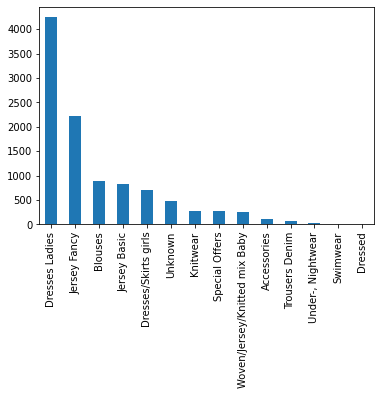

In [ ]:
dress.garment_group_name.value_counts().plot(kind='bar')

# Redefine the Groups and Re-Run

Jeans Samples: 98


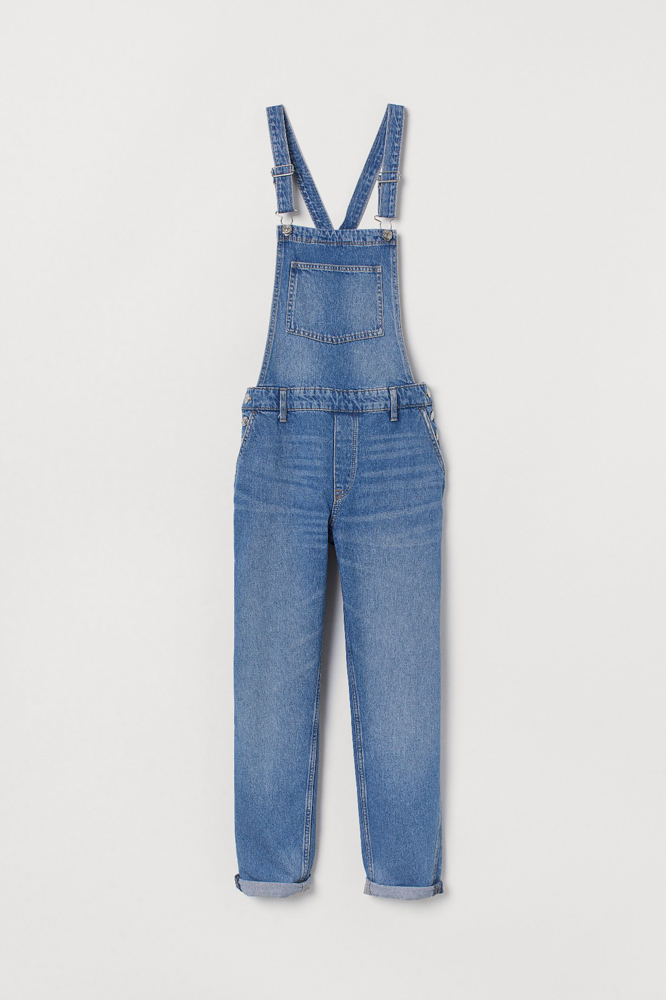

T-Shirts Samples: 2059


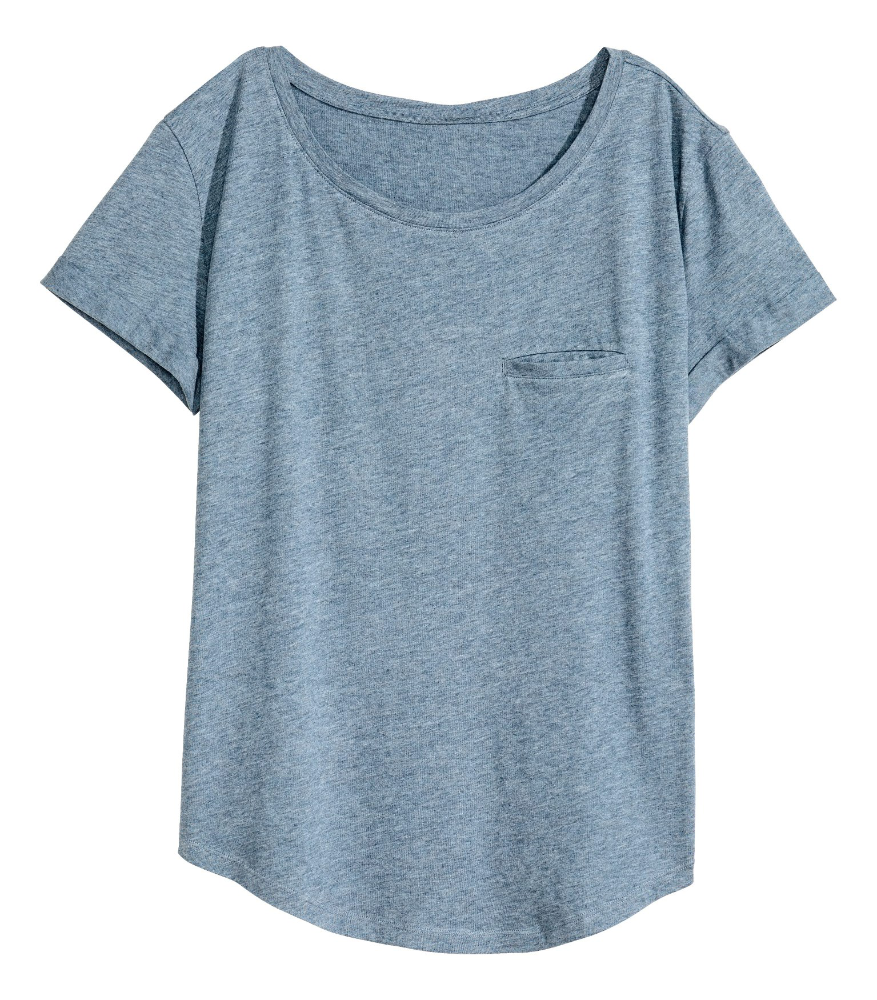

Blazer Samples: 1108


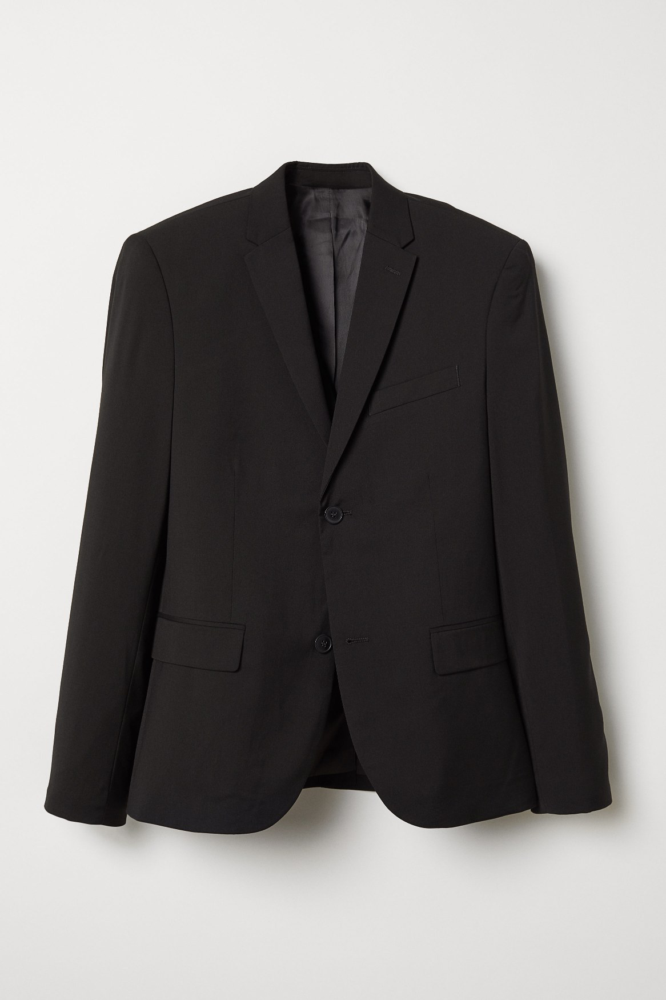

Dress Samples: 4244


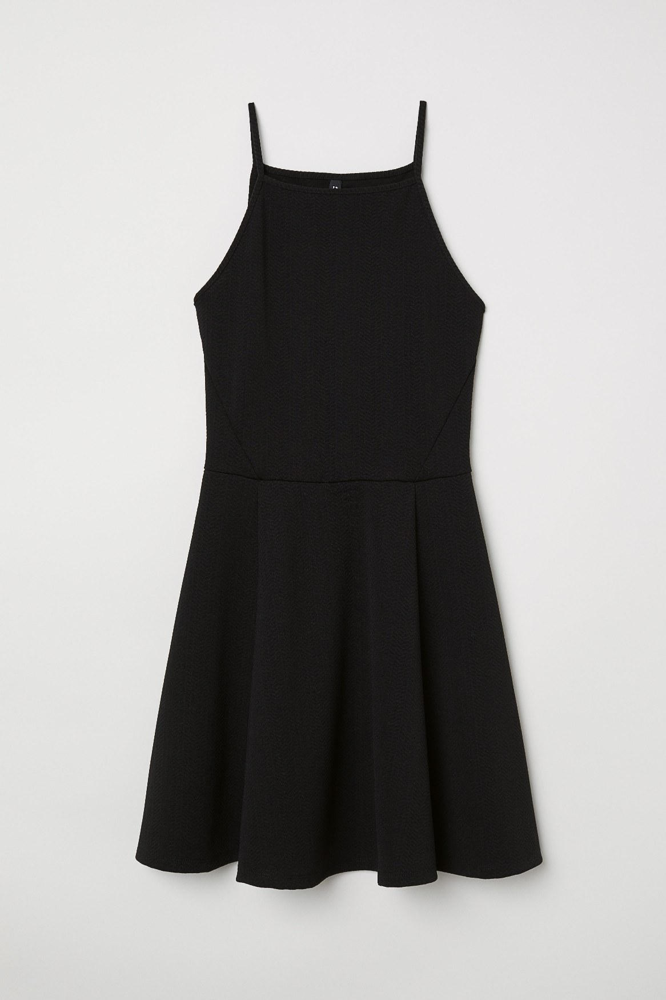

Boots Samples: 1028


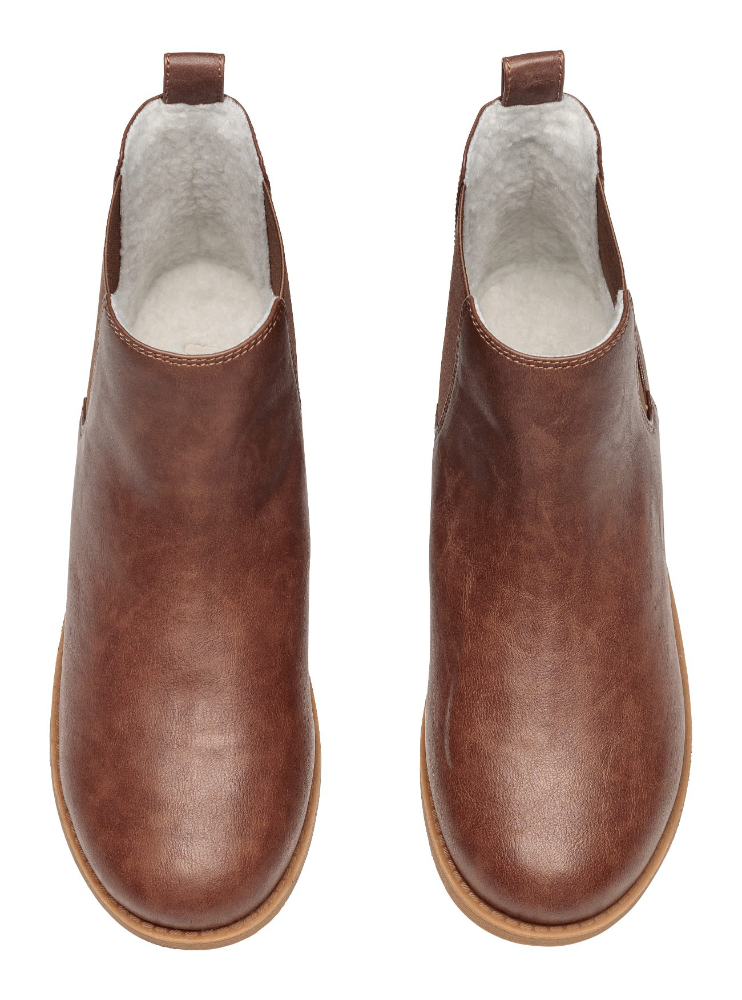

In [ ]:
jeans = articles[(articles.product_type_name=='Dungarees') & 
                 (articles.garment_group_name=='Trousers Denim')].reset_index(drop=True)
jeans.name = 'jeans'
t_shirts = articles[(articles.product_type_name=='T-shirt') &
                    (articles.garment_group_name=='Jersey Basic')].reset_index(drop=True)
t_shirts.name = 't_shirts'
blazer = articles[articles.product_type_name=='Blazer'].reset_index(drop=True)
blazer.name = 'blazer'
dress = articles[(articles.product_type_name=='Dress') & 
                 (articles.garment_group_name=='Dresses Ladies')].reset_index(drop=True)
dress.name = 'dress'
boots = articles[articles.product_type_name=='Boots'].reset_index(drop=True)
boots.name = 'boots'


print(f'Jeans Samples: {jeans.shape[0]}')
im = Image.open(os.path.join(img_dir, jeans.loc[0].article_id[:3], f'{jeans.loc[0].article_id}.jpg'))
display(im)
print(f'T-Shirts Samples: {t_shirts.shape[0]}')
im = Image.open(os.path.join(img_dir, t_shirts.loc[0].article_id[:3], f'{t_shirts.loc[0].article_id}.jpg'))
display(im)
print(f'Blazer Samples: {blazer.shape[0]}')
im = Image.open(os.path.join(img_dir, blazer.loc[0].article_id[:3], f'{blazer.loc[0].article_id}.jpg'))
display(im)
print(f'Dress Samples: {dress.shape[0]}')
im = Image.open(os.path.join(img_dir, dress.loc[0].article_id[:3], f'{dress.loc[0].article_id}.jpg'))
display(im)
print(f'Boots Samples: {boots.shape[0]}')
im = Image.open(os.path.join(img_dir, boots.loc[0].article_id[:3], f'{boots.loc[0].article_id}.jpg'))
display(im)

<AxesSubplot:xlabel='x', ylabel='y'>

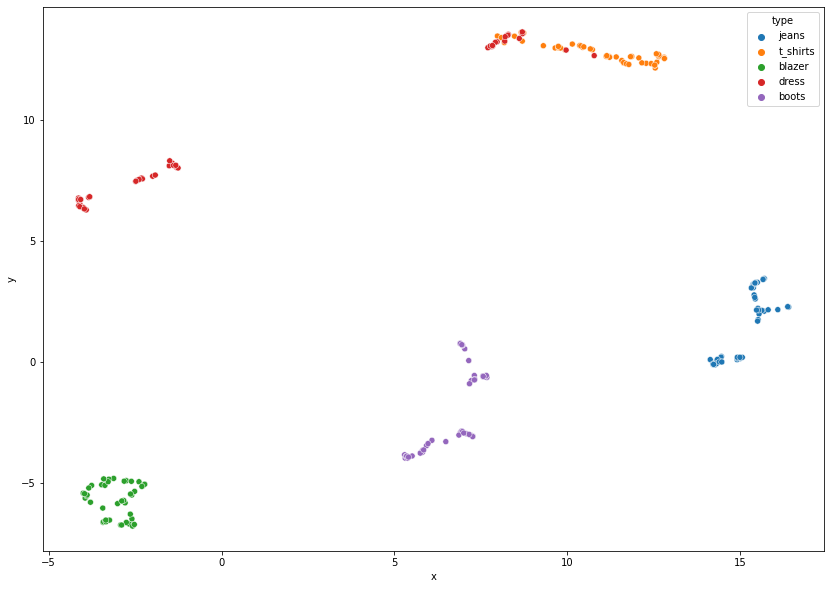

In [ ]:
_umap = umap.UMAP(
    n_neighbors=5,
    min_dist=0.0,
    n_components=2,
    random_state=42,
)

type_list = []
processed = []

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_mean(frame.loc[i].article_id))
      type_list.append(frame.name)

X = np.array(processed)
reduced = _umap.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y'])
df['type'] = type_list

plt.figure(figsize=(14,10))
sns.scatterplot(data=df, x="x", y="y", hue="type")

In [ ]:
_umap = umap.UMAP(
    n_neighbors=5,
    min_dist=0.0,
    n_components=3,
    random_state=42,
)

type_list = []
processed = []

for frame in [jeans,t_shirts,blazer,dress,boots]:
    for i in range(n):
      processed.append(getFeatureVecor_mean(frame.loc[i].article_id))
      type_list.append(frame.name)

X = np.array(processed)
reduced = _umap.fit_transform(X)
df = pd.DataFrame(reduced,columns=['x','y','z'])
df['type'] = type_list

fig = px.scatter_3d(df, x="x", y="y", z="z", color="type")
fig.show()

From the above two outputs that jeans, blazer, and boots result in distinct clusters, there are still some dresses that appear to me more similar to t-shirts. But this supports theory of using images as labels could be misleading.

# Clustering
For completness we will be completing actual clustering analysis. As this will be the last step of the embedding step of this study.

## KMeans

In [ ]:
d = defaultdict(list)
for n in list(range(2,15)):
  k_means = KMeans(n_clusters=n, max_iter=1000)
  k_means.fit(reduced)

  cluster_labels = k_means.labels_

  label=k_means.predict(reduced)
  d['num_clusters'].append(n)
  d['silhouette_scores'].append(silhouette_score(reduced, label))
  d['distortions'].append(sum(np.min(cdist(reduced, k_means.cluster_centers_,
                                        'euclidean'), axis=1)) / reduced.shape[0])

<AxesSubplot:xlabel='num_clusters'>

<Figure size 1008x720 with 0 Axes>

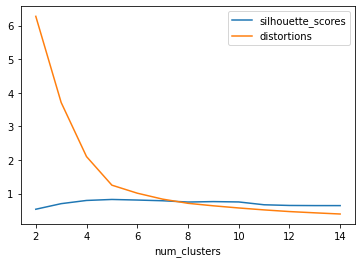

In [ ]:
_df = pd.DataFrame(d)
_df.set_index('num_clusters',inplace=True)
plt.figure(figsize=(14,10))
_df.plot()

In [ ]:
n = 7
k_means = KMeans(n_clusters=n, max_iter=1000)
k_means.fit(reduced)

df['cluster_id'] = k_means.predict(reduced)
fig = px.scatter_3d(df, x="x", y="y", z="z", color="cluster_id")
fig.show()

**Possible TO-DO** DBSCAN Optimization